# Brazilian E-Commerce Public Dataset by Olist
Dataset Source: https://www.kaggle.com/datasets/olistbr/brazilian-ecommerce

## Identifying Business Questions

- What is the total number of orders and the revenue turnover in our e-commerce for the last 12 months?
- What is the demographic profile of our e-commerce buyers? Which region spends the most? What is the predominant payment type?
- Which sellers generate the highest revenue, have the highest review ratings, and the fastest approved times?
- What product categories sell the most in long-distance, medium-distance, and short-distance shipments?
- Which product categories sell the most and the least?
- What is the relationship between the number of photos, description length, and sales volume?
- How does product volume and weight relate to freight value and delivery duration?
- What is the impact of review ratings on review answer time?
- Who are the top customers based on RFM parameters?

## Preparing necessary libraries

In [1]:
import pandas as pd
import numpy as np
import math
import os
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
from urllib.request import urlopen
import json

## Data Wrangling

### Gathering Data

In [2]:
# Specify dataset base folder
dataset_folder = r"./E-Commerce Public Dataset"
dataset_file_name = os.listdir(dataset_folder)

# Iterate to get .csv file name
csv_file_name = []
for file in dataset_file_name:
    if file.endswith(".csv"):
        csv_file_name.append(file)

In [3]:
df_customers = pd.read_csv(os.path.join(dataset_folder, csv_file_name[0]))
df_geolocation = pd.read_csv(os.path.join(dataset_folder, csv_file_name[1]))
df_orders = pd.read_csv(os.path.join(dataset_folder, csv_file_name[2]))
df_order_items = pd.read_csv(os.path.join(dataset_folder, csv_file_name[3]))
df_order_payments = pd.read_csv(os.path.join(dataset_folder, csv_file_name[4]))
df_order_reviews = pd.read_csv(os.path.join(dataset_folder, csv_file_name[5]))
df_products = pd.read_csv(os.path.join(dataset_folder, csv_file_name[6]))
df_product_cat_trans = pd.read_csv(os.path.join(dataset_folder, csv_file_name[7]))
df_sellers = pd.read_csv(os.path.join(dataset_folder, csv_file_name[8]))

In [4]:
df_customers.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP


In [5]:
df_geolocation.head()

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,1037,-23.545621,-46.639292,sao paulo,SP
1,1046,-23.546081,-46.644820,sao paulo,SP
2,1046,-23.546129,-46.642951,sao paulo,SP
3,1041,-23.544392,-46.639499,sao paulo,SP
4,1035,-23.541578,-46.641607,sao paulo,SP


In [6]:
df_orders.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00


In [7]:
df_order_items.head()

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.90,13.29
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,dd7ddc04e1b6c2c614352b383efe2d36,2017-05-03 11:05:13,239.90,19.93
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d,2018-01-18 14:48:30,199.00,17.87
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,9d7a1d34a5052409006425275ba1c2b4,2018-08-15 10:10:18,12.99,12.79
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,df560393f3a51e74553ab94004ba5c87,2017-02-13 13:57:51,199.90,18.14


In [8]:
df_order_payments.head()

,order_id,payment_sequential,payment_type,payment_installments,payment_value
0,b81ef226f3fe1789b1e8b2acac839d17,1,credit_card,8,99.33
1,a9810da82917af2d9aefd1278f1dcfa0,1,credit_card,1,24.39
2,25e8ea4e93396b6fa0d3dd708e76c1bd,1,credit_card,1,65.71
3,ba78997921bbcdc1373bb41e913ab953,1,credit_card,8,107.78
4,42fdf880ba16b47b59251dd489d4441a,1,credit_card,2,128.45


In [9]:
df_order_reviews.head()

,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
0,7bc2406110b926393aa56f80a40eba40,73fc7af87114b39712e6da79b0a377eb,4,NaN,NaN,2018-01-18 00:00:00,2018-01-18 21:46:59
1,80e641a11e56f04c1ad469d5645fdfde,a548910a1c6147796b98fdf73dbeba33,5,NaN,NaN,2018-03-10 00:00:00,2018-03-11 03:05:13
2,228ce5500dc1d8e020d8d1322874b6f0,f9e4b658b201a9f2ecdecbb34bed034b,5,NaN,NaN,2018-02-17 00:00:00,2018-02-18 14:36:24
3,e64fb393e7b32834bb789ff8bb30750e,658677c97b385a9be170737859d3511b,5,NaN,Recebi bem antes do prazo estipulado.,2017-04-21 00:00:00,2017-04-21 22:02:06
4,f7c4243c7fe1938f181bec41a392bdeb,8e6bfb81e283fa7e4f11123a3fb894f1,5,NaN,Parabéns lojas lannister adorei comprar pela I...,2018-03-01 00:00:00,2018-03-02 10:26:53


In [10]:
df_products.head()

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,40.0,287.0,1.0,225.0,16.0,10.0,14.0
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,44.0,276.0,1.0,1000.0,30.0,18.0,20.0
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,46.0,250.0,1.0,154.0,18.0,9.0,15.0
3,cef67bcfe19066a932b7673e239eb23d,bebes,27.0,261.0,1.0,371.0,26.0,4.0,26.0
4,9dc1a7de274444849c219cff195d0b71,utilidades_domesticas,37.0,402.0,4.0,625.0,20.0,17.0,13.0


In [11]:
df_product_cat_trans.head()

,product_category_name,product_category_name_english
0,beleza_saude,health_beauty
1,informatica_acessorios,computers_accessories
2,automotivo,auto
3,cama_mesa_banho,bed_bath_table
4,moveis_decoracao,furniture_decor


In [12]:
df_sellers.head()

,seller_id,seller_zip_code_prefix,seller_city,seller_state
0,3442f8959a84dea7ee197c632cb2df15,13023,campinas,SP
1,d1b65fc7debc3361ea86b5f14c68d2e2,13844,mogi guacu,SP
2,ce3ad9de960102d0677a81f5d0bb7b2d,20031,rio de janeiro,RJ
3,c0f3eea2e14555b6faeea3dd58c1b1c3,4195,sao paulo,SP
4,51a04a8a6bdcb23deccc82b0b80742cf,12914,braganca paulista,SP


### Assessing Data

#### Customers Dataset

In [13]:
df_customers.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Data columns (total 5 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   customer_id               99441 non-null  object
 1   customer_unique_id        99441 non-null  object
 2   customer_zip_code_prefix  99441 non-null  int64 
 3   customer_city             99441 non-null  object
 4   customer_state            99441 non-null  object
dtypes: int64(1), object(4)
memory usage: 3.8+ MB


In [14]:
print("Total duplicate values: ", df_customers.duplicated().sum())

Total duplicate values:  0


#### Geolocation Dataset

In [15]:
df_geolocation.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000163 entries, 0 to 1000162
Data columns (total 5 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   geolocation_zip_code_prefix  1000163 non-null  int64  
 1   geolocation_lat              1000163 non-null  float64
 2   geolocation_lng              1000163 non-null  float64
 3   geolocation_city             1000163 non-null  object 
 4   geolocation_state            1000163 non-null  object 
dtypes: float64(2), int64(1), object(2)
memory usage: 38.2+ MB


In [16]:
print("Total duplicate values: ", df_geolocation.duplicated().sum())

Total duplicate values:  261831


In [17]:
df_geolocation.describe()

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng
count,1.000163e+06,1.000163e+06,1.000163e+06
mean,3.657417e+04,-2.117615e+01,-4.639054e+01
std,3.054934e+04,5.715866e+00,4.269748e+00
min,1.001000e+03,-3.660537e+01,-1.014668e+02
25%,1.107500e+04,-2.360355e+01,-4.857317e+01
50%,2.653000e+04,-2.291938e+01,-4.663788e+01
75%,6.350400e+04,-1.997962e+01,-4.376771e+01
max,9.999000e+04,4.506593e+01,1.211054e+02


#### Orders Dataset

In [18]:
df_orders.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Data columns (total 8 columns):
 #   Column                         Non-Null Count  Dtype 
---  ------                         --------------  ----- 
 0   order_id                       99441 non-null  object
 1   customer_id                    99441 non-null  object
 2   order_status                   99441 non-null  object
 3   order_purchase_timestamp       99441 non-null  object
 4   order_approved_at              99281 non-null  object
 5   order_delivered_carrier_date   97658 non-null  object
 6   order_delivered_customer_date  96476 non-null  object
 7   order_estimated_delivery_date  99441 non-null  object
dtypes: object(8)
memory usage: 6.1+ MB


In [19]:
df_orders.isna().sum()

order_id                            0
customer_id                         0
order_status                        0
order_purchase_timestamp            0
order_approved_at                 160
order_delivered_carrier_date     1783
order_delivered_customer_date    2965
order_estimated_delivery_date       0
dtype: int64

In [20]:
print("Total duplicate values: ", df_orders.duplicated().sum())

Total duplicate values:  0


#### Order Items Dataset

In [21]:
df_order_items.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 112650 entries, 0 to 112649
Data columns (total 7 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   order_id             112650 non-null  object 
 1   order_item_id        112650 non-null  int64  
 2   product_id           112650 non-null  object 
 3   seller_id            112650 non-null  object 
 4   shipping_limit_date  112650 non-null  object 
 5   price                112650 non-null  float64
 6   freight_value        112650 non-null  float64
dtypes: float64(2), int64(1), object(4)
memory usage: 6.0+ MB


In [22]:
df_order_items.describe()

,order_item_id,price,freight_value
count,112650.000000,112650.000000,112650.000000
mean,1.197834,120.653739,19.990320
std,0.705124,183.633928,15.806405
min,1.000000,0.850000,0.000000
25%,1.000000,39.900000,13.080000
50%,1.000000,74.990000,16.260000
75%,1.000000,134.900000,21.150000
max,21.000000,6735.000000,409.680000


In [23]:
print("Total duplicate values: ", df_order_items.duplicated().sum())

Total duplicate values:  0


#### Order Payments Dataset

In [24]:
df_order_payments.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 103886 entries, 0 to 103885
Data columns (total 5 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   order_id              103886 non-null  object 
 1   payment_sequential    103886 non-null  int64  
 2   payment_type          103886 non-null  object 
 3   payment_installments  103886 non-null  int64  
 4   payment_value         103886 non-null  float64
dtypes: float64(1), int64(2), object(2)
memory usage: 4.0+ MB


In [25]:
df_order_payments.describe()

,payment_sequential,payment_installments,payment_value
count,103886.000000,103886.000000,103886.000000
mean,1.092679,2.853349,154.100380
std,0.706584,2.687051,217.494064
min,1.000000,0.000000,0.000000
25%,1.000000,1.000000,56.790000
50%,1.000000,1.000000,100.000000
75%,1.000000,4.000000,171.837500
max,29.000000,24.000000,13664.080000


In [26]:
print("Total duplicate values: ", df_order_payments.duplicated().sum())

Total duplicate values:  0


#### Order Reviews Dataset

In [27]:
df_order_reviews.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99224 entries, 0 to 99223
Data columns (total 7 columns):
 #   Column                   Non-Null Count  Dtype 
---  ------                   --------------  ----- 
 0   review_id                99224 non-null  object
 1   order_id                 99224 non-null  object
 2   review_score             99224 non-null  int64 
 3   review_comment_title     11568 non-null  object
 4   review_comment_message   40977 non-null  object
 5   review_creation_date     99224 non-null  object
 6   review_answer_timestamp  99224 non-null  object
dtypes: int64(1), object(6)
memory usage: 5.3+ MB


In [28]:
df_order_reviews.describe()

,review_score
count,99224.000000
mean,4.086421
std,1.347579
min,1.000000
25%,4.000000
50%,5.000000
75%,5.000000
max,5.000000


In [29]:
print("Total duplicate values: ", df_order_reviews.duplicated().sum())

Total duplicate values:  0


#### Products Dataset

In [30]:
df_products.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32951 entries, 0 to 32950
Data columns (total 9 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   product_id                  32951 non-null  object 
 1   product_category_name       32341 non-null  object 
 2   product_name_lenght         32341 non-null  float64
 3   product_description_lenght  32341 non-null  float64
 4   product_photos_qty          32341 non-null  float64
 5   product_weight_g            32949 non-null  float64
 6   product_length_cm           32949 non-null  float64
 7   product_height_cm           32949 non-null  float64
 8   product_width_cm            32949 non-null  float64
dtypes: float64(7), object(2)
memory usage: 2.3+ MB


In [31]:
df_products.describe()

,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
count,32341.000000,32341.000000,32341.000000,32949.000000,32949.000000,32949.000000,32949.000000
mean,48.476949,771.495285,2.188986,2276.472488,30.815078,16.937661,23.196728
std,10.245741,635.115225,1.736766,4282.038731,16.914458,13.637554,12.079047
min,5.000000,4.000000,1.000000,0.000000,7.000000,2.000000,6.000000
25%,42.000000,339.000000,1.000000,300.000000,18.000000,8.000000,15.000000
50%,51.000000,595.000000,1.000000,700.000000,25.000000,13.000000,20.000000
75%,57.000000,972.000000,3.000000,1900.000000,38.000000,21.000000,30.000000
max,76.000000,3992.000000,20.000000,40425.000000,105.000000,105.000000,118.000000


In [32]:
print("Total duplicate values: ", df_products.duplicated().sum())

Total duplicate values:  0


#### Product Category Name Translation Dataset

In [33]:
df_product_cat_trans.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 71 entries, 0 to 70
Data columns (total 2 columns):
 #   Column                         Non-Null Count  Dtype 
---  ------                         --------------  ----- 
 0   product_category_name          71 non-null     object
 1   product_category_name_english  71 non-null     object
dtypes: object(2)
memory usage: 1.2+ KB


In [34]:
df_product_cat_trans.describe()

,product_category_name,product_category_name_english
count,71,71
unique,71,71
top,beleza_saude,health_beauty
freq,1,1


In [35]:
print("Total duplicate values: ", df_product_cat_trans.duplicated().sum())

Total duplicate values:  0


#### Sellers Dataset

In [36]:
df_sellers.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3095 entries, 0 to 3094
Data columns (total 4 columns):
 #   Column                  Non-Null Count  Dtype 
---  ------                  --------------  ----- 
 0   seller_id               3095 non-null   object
 1   seller_zip_code_prefix  3095 non-null   int64 
 2   seller_city             3095 non-null   object
 3   seller_state            3095 non-null   object
dtypes: int64(1), object(3)
memory usage: 96.8+ KB


In [37]:
print("Total duplicate values: ", df_sellers.duplicated().sum())

Total duplicate values:  0


### Cleaning Data

#### Customers Dataset

In [38]:
# Trim the unique id to get the last 8 value.
# 8 is picked because using this value, condition where df_customers['customer_unique_id'].duplicated().sum() = df_customers['customer_unique_id_short'].duplicated().sum() met

df_customers['customer_unique_id_short'] = df_customers['customer_unique_id'].str[-8:]

# Create dictionary of the mapping
cust_short_to_long = dict(zip(df_customers['customer_unique_id_short'], df_customers['customer_unique_id']))

#### Geolocation Dataset

In [39]:
# Drop duplicated data
print("Total duplicate values before cleaning: ", df_geolocation.duplicated().sum())
df_geolocation.drop_duplicates(inplace=True)
print("Total duplicate values after cleaning: ", df_geolocation.duplicated().sum())

Total duplicate values before cleaning:  261831
Total duplicate values after cleaning:  0


In [40]:
# Simplified the dataset since the rows are huge, and difference between coordinate is not that much
# Hence, it will be groupped by the zip code prefix and find the average coordinate
df_geolocation = df_geolocation.groupby(by='geolocation_zip_code_prefix').agg({
    "geolocation_lat":"mean",
    "geolocation_lng":"mean",
})

#### Orders Dataset

In [41]:
# Change data type to datetime

datetime_columns = ['order_purchase_timestamp','order_approved_at', 'order_delivered_carrier_date', 'order_delivered_customer_date', 'order_estimated_delivery_date']
for column in datetime_columns:
    df_orders[column] = pd.to_datetime(df_orders[column])

##### order_approved_at is null

In [42]:
# Check category of order status when 'order_approved_at' contain null value
df_orders[df_orders.order_approved_at.isna()].order_status.value_counts()

order_status
canceled     141
delivered     14
created        5
Name: count, dtype: int64

In [43]:
df_orders[~df_orders.order_approved_at.isna()].order_status.value_counts()

order_status
delivered      96464
shipped         1107
unavailable      609
canceled         484
invoiced         314
processing       301
approved           2
Name: count, dtype: int64

In [44]:
# Find ratio of this null property at "order_approved_at" column with entire population
count_null_canceled = df_orders[(df_orders.order_approved_at.isna()) & (df_orders.order_status=="canceled")].shape[0]
count_not_null_canceled = df_orders[(df_orders.order_status=="canceled")].shape[0]
ratio_null_canceled = (count_null_canceled)*100 / count_not_null_canceled

count_null_delivered= df_orders[(df_orders.order_approved_at.isna()) & (df_orders.order_status=="delivered")].shape[0]
count_not_null_delivered = df_orders[(df_orders.order_status=="delivered")].shape[0]
ratio_null_delivered = (count_null_delivered)*100 / count_not_null_delivered

count_null_created= df_orders[(df_orders.order_approved_at.isna()) & (df_orders.order_status=="created")].shape[0]
count_not_null_created = df_orders[(df_orders.order_status=="created")].shape[0]
ratio_null_created = (count_null_created)*100 / count_not_null_created

print("%.2f%% of canceled order status don't have order_approved_at value" %ratio_null_canceled)
print("%.2f%% of delivered order status don't have order_approved_at value" %ratio_null_delivered)
print("%.2f%% of created order status don't have order_approved_at value" %ratio_null_created)

22.56% of canceled order status don't have order_approved_at value
0.01% of delivered order status don't have order_approved_at value
100.00% of created order status don't have order_approved_at value


In [45]:
# Drop rows where order status is delivered and order_approved_at is null
df_orders.drop(df_orders[(df_orders.order_approved_at.isna()) & (df_orders.order_status == "delivered")].index, inplace=True)

##### order_delivered_customer_date is null

In [46]:
# Check category of order status when 'order_delivered_customer_date' contain null value
df_orders[df_orders.order_delivered_customer_date.isna()].order_status.value_counts()

order_status
shipped        1107
canceled        619
unavailable     609
invoiced        314
processing      301
delivered         8
created           5
approved          2
Name: count, dtype: int64

In [47]:
df_orders[~df_orders.order_delivered_customer_date.isna()].order_status.value_counts()

order_status
delivered    96456
canceled         6
Name: count, dtype: int64

In [48]:
# Drop rows with condition if order_status is delivered and order_delivered_customer_date contain null
df_orders.drop(df_orders[(df_orders.order_delivered_customer_date.isna())&(df_orders.order_status=="delivered")].index, inplace=True)

In [49]:
# Drop rows with condition if order_status is canceled and order_delivered_customer_date not null
df_orders.drop(df_orders[(~df_orders.order_delivered_customer_date.isna())&(df_orders.order_status=="canceled")].index, inplace=True)

##### order_delivered_carrier_date is null

In [50]:
# Check category of order status when 'order_delivered_carrier_date' contain null value
df_orders[df_orders.order_delivered_carrier_date.isna()].order_status.value_counts()

order_status
unavailable    609
canceled       550
invoiced       314
processing     301
created          5
approved         2
delivered        1
Name: count, dtype: int64

In [51]:
df_orders[~df_orders.order_delivered_carrier_date.isna()].order_status.value_counts()

order_status
delivered    96455
shipped       1107
canceled        69
Name: count, dtype: int64

In [52]:
# Drop rows with condition if order_status is delivered and order_delivered_carrier_date is null
df_orders.drop(df_orders[(df_orders.order_delivered_carrier_date.isna())&(df_orders.order_status == "delivered")].index, inplace=True)

In [53]:
# Lastly, order status canceled will be dropped because it doesn't give us too much information
df_orders.drop(df_orders[df_orders.order_status =='canceled'].index, inplace=True)

#### Order Items Dataset

In [54]:
# Convert data type of column 'shipping_limit_date' to datetime

df_order_items['shipping_limit_date'] = pd.to_datetime(df_order_items['shipping_limit_date'])

#### Order Payments Dataset

#### Order Reviews Dataset

In [55]:
# Convert data type of column 'review_creation_date' and 'review_answer_timestamp' to datetime
# Leave 'review_comment_title' and 'review_comment_message' null values as is

datetime_columns = ['review_creation_date','review_answer_timestamp']
for column in datetime_columns:
    df_order_reviews[column] = pd.to_datetime(df_order_reviews[column])

#### Products Dataset

In [56]:
# Inspect product weight that have value 0 gram

df_products[df_products.product_weight_g==0]

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
9769,81781c0fed9fe1ad6e8c81fca1e1cb08,cama_mesa_banho,51.0,529.0,1.0,0.0,30.0,25.0,30.0
13683,8038040ee2a71048d4bdbbdc985b69ab,cama_mesa_banho,48.0,528.0,1.0,0.0,30.0,25.0,30.0
14997,36ba42dd187055e1fbe943b2d11430ca,cama_mesa_banho,53.0,528.0,1.0,0.0,30.0,25.0,30.0
32079,e673e90efa65a5409ff4196c038bb5af,cama_mesa_banho,53.0,528.0,1.0,0.0,30.0,25.0,30.0


In [57]:
count_cama_mesa_banho = df_products[df_products.product_category_name=="cama_mesa_banho"].shape[0]

print("Count where product category name is cama_mesa_banho:  %.0f rows" %count_cama_mesa_banho)

Count where product category name is cama_mesa_banho:  3029 rows


In [58]:
mean_weight_came_masa = df_products[df_products.product_category_name=="cama_mesa_banho"].product_weight_g.mean()
std_weight_came_masa = df_products[df_products.product_category_name=="cama_mesa_banho"].product_weight_g.std()

print(f'Average weight of product category cama_mesa_banho is {mean_weight_came_masa:.2f} ± {std_weight_came_masa:.2f}')

Average weight of product category cama_mesa_banho is 2456.41 ± 3732.67


In [59]:
# Translate the product name
df_product_cat_trans[df_product_cat_trans.product_category_name=="cama_mesa_banho"]

,product_category_name,product_category_name_english
3,cama_mesa_banho,bed_bath_table


In [60]:
# Drop rows where product weight is 0 gr
df_products.drop((df_products[df_products.product_weight_g==0]).index, inplace=True)

#### Product Category Name Translation Dataset

#### Sellers Dataset

In [61]:
df_sellers.duplicated().sum()

0

In [62]:
# Becasue there is no duplicated seller_id in sellers dataframe,
# hence seller_id_short will be create using sequential number and be mapped to dictionary in case it want to be looked up 
seller_id_count = df_sellers.seller_id.count()
df_sellers['seller_id_short'] = [f"SELLER-{i}" for i in range(1, seller_id_count+1)]

# Create dictionary of the mapping
seller_short_to_long = dict(zip(df_sellers['seller_id_short'], df_sellers['seller_id']))

## Exploratory Data Analysis (EDA)

### Explore Customers Dataset

In [63]:
df_customers.describe(include="all")

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,customer_unique_id_short
count,99441,99441,99441.000000,99441,99441,99441
unique,99441,96096,NaN,4119,27,96096
top,06b8999e2fba1a1fbc88172c00ba8bc7,8d50f5eadf50201ccdcedfb9e2ac8455,NaN,sao paulo,SP,e2ac8455
freq,1,17,NaN,15540,41746,17
mean,NaN,NaN,35137.474583,NaN,NaN,NaN
std,NaN,NaN,29797.938996,NaN,NaN,NaN
min,NaN,NaN,1003.000000,NaN,NaN,NaN
25%,NaN,NaN,11347.000000,NaN,NaN,NaN
50%,NaN,NaN,24416.000000,NaN,NaN,NaN
75%,NaN,NaN,58900.000000,NaN,NaN,NaN


In [64]:
df_customers.groupby(by='customer_state').customer_id.nunique().sort_values(ascending=False)

customer_state
SP    41746
RJ    12852
MG    11635
RS     5466
PR     5045
SC     3637
BA     3380
DF     2140
ES     2033
GO     2020
PE     1652
CE     1336
PA      975
MT      907
MA      747
MS      715
PB      536
PI      495
RN      485
AL      413
SE      350
TO      280
RO      253
AM      148
AC       81
AP       68
RR       46
Name: customer_id, dtype: int64

In [65]:
df_customers.groupby(by='customer_city').customer_id.nunique().sort_values(ascending=False)

customer_city
sao paulo         15540
rio de janeiro     6882
belo horizonte     2773
brasilia           2131
curitiba           1521
                  ...  
ibiara                1
rio espera            1
rio dos indios        1
rio dos cedros        1
lagoao                1
Name: customer_id, Length: 4119, dtype: int64

In [66]:
# Check city of customers based on SP state
df_customers[df_customers.customer_state=="SP"].customer_city.value_counts()

customer_city
sao paulo                  15540
campinas                    1444
guarulhos                   1189
sao bernardo do campo        938
santo andre                  796
                           ...  
botelho                        1
aparecida de monte alto        1
novais                         1
santa clara d'oeste            1
natividade da serra            1
Name: count, Length: 629, dtype: int64

In [67]:
# Check city of customers based on RJ state
df_customers[df_customers.customer_state=="RJ"].customer_city.value_counts()

customer_city
rio de janeiro              6882
niteroi                      849
nova iguacu                  442
sao goncalo                  409
duque de caxias              266
                            ... 
lidice                         1
purilandia                     1
santa rita da floresta         1
mussurepe                      1
sao sebastiao do paraiba       1
Name: count, Length: 149, dtype: int64

In [68]:
# Retrieve longitude latitude coordinate of customer city
df_customers = pd.merge(
    left=df_customers,
    right=df_geolocation,
    how="left",
    left_on="customer_zip_code_prefix",
    right_on="geolocation_zip_code_prefix"
)
df_customers.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,customer_unique_id_short,geolocation_lat,geolocation_lng
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,dd7febb0,-20.499273,-47.396658
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP,6c333dc3,-23.728396,-46.542250
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP,7b0b2b5e,-23.531309,-46.656690
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP,bbff3f3c,-23.500670,-46.186348
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,73b8d066,-22.975708,-47.143140


### Explore Sellers Dataset

In [69]:
# Retrieve longitude latitude coordinate of seller city
df_sellers = pd.merge(
    left=df_sellers,
    right=df_geolocation,
    how="left",
    left_on="seller_zip_code_prefix",
    right_on="geolocation_zip_code_prefix"
)
df_sellers.head()

,seller_id,seller_zip_code_prefix,seller_city,seller_state,seller_id_short,geolocation_lat,geolocation_lng
0,3442f8959a84dea7ee197c632cb2df15,13023,campinas,SP,SELLER-1,-22.893317,-47.060596
1,d1b65fc7debc3361ea86b5f14c68d2e2,13844,mogi guacu,SP,SELLER-2,-22.383375,-46.948142
2,ce3ad9de960102d0677a81f5d0bb7b2d,20031,rio de janeiro,RJ,SELLER-3,-22.909446,-43.180240
3,c0f3eea2e14555b6faeea3dd58c1b1c3,4195,sao paulo,SP,SELLER-4,-23.657118,-46.612730
4,51a04a8a6bdcb23deccc82b0b80742cf,12914,braganca paulista,SP,SELLER-5,-22.964546,-46.534214


### Explore Orders Dataset

In [70]:
# Create delivery time column in days based on purchase time until order delivered to customer
delivery_time = df_orders["order_delivered_customer_date"] - df_orders["order_purchase_timestamp"]
delivery_time = delivery_time.apply(lambda x: x.total_seconds())
df_orders["delivery_time"]=round(delivery_time/86400)

In [71]:
# Create approved time column in minutes based on order purchase timestamp until order being approved
approved_time = df_orders["order_approved_at"] - df_orders["order_purchase_timestamp"]
approved_time_s = approved_time.apply(lambda x: x.total_seconds())
df_orders["approved_time_s"]=approved_time_s

In [72]:
approved_time_min = df_orders["approved_time_s"].min()
count_approved_time_0 = df_orders[df_orders["approved_time_s"]==approved_time_min].shape[0]

print('Minimum approved time is ', approved_time_min)
print('There are {} rows where minimum approved time is {}'.format(count_approved_time_0, approved_time_min))

Minimum approved time is  0.0
There are 1278 rows where minimum approved time is 0.0


In [73]:
# Find order approved time which is higher than 0 second and less than 3600s or 1 hour
df_orders[(df_orders["approved_time_s"]>0) & (df_orders["approved_time_s"]<3600)].sort_values(by="approved_time_s", ascending=True)

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,delivery_time,approved_time_s
66203,a0b25b40a41bd77646acd57a2e1744e6,b826fbf79786885fe1c10736318b7161,delivered,2017-05-23 04:59:50,2017-05-23 05:05:09,2017-05-23 14:27:14,2017-05-26 11:53:49,2017-06-05,3.0,319.0
59493,75d828fcad4255d3777465dc3050a8f5,49eba0e67920f32999db394895d656f4,delivered,2017-12-28 08:41:57,2017-12-28 08:47:20,2017-12-28 16:29:15,2018-01-05 17:03:26,2018-01-29,8.0,323.0
21292,5afde427b56e7f939052c2f2e54c628a,81f26f08d7362e24779a1f097ff2a997,delivered,2017-12-28 16:03:56,2017-12-28 16:09:20,2018-01-02 18:34:04,2018-01-08 20:23:11,2018-01-18,11.0,324.0
43706,dd39a3c7afa0c93e2d1e3580594f09e5,b9fd82369a040ab316a88a1177de4cde,delivered,2017-10-29 18:49:47,2017-10-29 18:55:14,2017-10-31 17:27:33,2017-11-03 21:58:46,2017-11-22,5.0,327.0
90937,9bb64540c8b861abd76559cbf18a9230,df6080c9c9123b2b968aa62b0cc5bbdb,delivered,2017-11-21 08:25:55,2017-11-21 08:31:24,2017-11-21 16:52:17,2017-11-28 23:37:53,2017-12-14,8.0,329.0
...,...,...,...,...,...,...,...,...,...,...
49906,fffa82886406ccf10c7b4e35c4ff2788,a5201e1a6d71a8d21e869151bd5b4085,delivered,2017-12-18 16:33:07,2017-12-18 17:33:04,2017-12-20 18:55:00,2018-01-08 18:23:10,2018-01-24,21.0,3597.0
16517,c5f0b9e8bd23e3d37855d76739573355,2d168556d327700dc590e84a3b12112d,delivered,2018-02-05 17:50:38,2018-02-05 18:50:35,2018-02-08 22:32:27,2018-02-20 21:55:22,2018-03-06,15.0,3597.0
7069,e407655a139ac261ec2f43315ea354d9,145ab3eb2ae5caaed9ce924fd138cd48,delivered,2018-02-21 11:05:24,2018-02-21 12:05:22,2018-02-21 21:53:13,2018-03-06 18:21:56,2018-03-19,13.0,3598.0
2974,14001e8cd1c29d0bce5b5bfca73338af,620c2e659b5d119813362bfe4bbe8634,delivered,2018-01-31 00:04:39,2018-01-31 01:04:38,2018-01-31 19:48:59,2018-02-05 21:21:21,2018-02-23,6.0,3599.0


In [74]:
# Replacing those values with NaN
df_orders.loc[df_orders["approved_time_s"] == 0, "approved_time_s"] = np.nan

# Replace this column from seconds to minutes
df_orders["approved_time_m"] = df_orders["approved_time_s"].apply(lambda x: x/60)

df_orders.drop("approved_time_s", axis=1, inplace=True)

In [75]:
df_orders.describe(include="all")

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,delivery_time,approved_time_m
count,98793,98793,98793,98793,98788,97562,96455,98793,96455.000000,97510.000000
unique,98793,98793,7,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,1,1,96455,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,NaN,NaN,2017-12-31 12:10:11.696192768,2017-12-31 22:35:39.575282176,2018-01-04 22:37:46.293003520,2018-01-14 13:49:28.328525824,2018-01-24 06:43:07.592238336,12.516510,632.130766
min,NaN,NaN,NaN,2016-09-04 21:15:19,2016-09-15 12:16:38,2016-10-08 10:34:01,2016-10-11 13:46:32,2016-10-04 00:00:00,1.000000,5.316667
25%,NaN,NaN,NaN,2017-09-12 19:07:38,2017-09-13 03:35:54.249999872,2017-09-15 21:49:51.249999872,2017-09-25 22:56:47,2017-10-04 00:00:00,7.000000,13.100000
50%,NaN,NaN,NaN,2018-01-18 22:23:16,2018-01-19 10:32:58.500000,2018-01-24 14:24:39.500000,2018-02-02 19:52:30,2018-02-15 00:00:00,10.000000,21.016667
75%,NaN,NaN,NaN,2018-05-04 14:21:11,2018-05-04 21:10:20.249999872,2018-05-08 13:49:45,2018-05-15 23:09:15.500000,2018-05-25 00:00:00,16.000000,898.337500
max,NaN,NaN,NaN,2018-09-03 09:06:57,2018-09-03 17:40:06,2018-09-11 19:48:28,2018-10-17 13:22:46,2018-10-25 00:00:00,210.000000,270550.833333


### Explore Order Reviews Dataset

In [76]:
review_answer_time = df_order_reviews['review_answer_timestamp'] - df_order_reviews['review_creation_date']
review_answer_time = review_answer_time.apply(lambda x: x.total_seconds())
df_order_reviews['review_answer_time_h'] = round(review_answer_time/3600)

df_order_reviews.head()

,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp,review_answer_time_h
0,7bc2406110b926393aa56f80a40eba40,73fc7af87114b39712e6da79b0a377eb,4,NaN,NaN,2018-01-18,2018-01-18 21:46:59,22.0
1,80e641a11e56f04c1ad469d5645fdfde,a548910a1c6147796b98fdf73dbeba33,5,NaN,NaN,2018-03-10,2018-03-11 03:05:13,27.0
2,228ce5500dc1d8e020d8d1322874b6f0,f9e4b658b201a9f2ecdecbb34bed034b,5,NaN,NaN,2018-02-17,2018-02-18 14:36:24,39.0
3,e64fb393e7b32834bb789ff8bb30750e,658677c97b385a9be170737859d3511b,5,NaN,Recebi bem antes do prazo estipulado.,2017-04-21,2017-04-21 22:02:06,22.0
4,f7c4243c7fe1938f181bec41a392bdeb,8e6bfb81e283fa7e4f11123a3fb894f1,5,NaN,Parabéns lojas lannister adorei comprar pela I...,2018-03-01,2018-03-02 10:26:53,34.0


In [77]:
df_order_reviews.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99224 entries, 0 to 99223
Data columns (total 8 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   review_id                99224 non-null  object        
 1   order_id                 99224 non-null  object        
 2   review_score             99224 non-null  int64         
 3   review_comment_title     11568 non-null  object        
 4   review_comment_message   40977 non-null  object        
 5   review_creation_date     99224 non-null  datetime64[ns]
 6   review_answer_timestamp  99224 non-null  datetime64[ns]
 7   review_answer_time_h     99224 non-null  float64       
dtypes: datetime64[ns](2), float64(1), int64(1), object(4)
memory usage: 6.1+ MB


### Explore Order Items, Products & Translate -> df_order_items_translated

In [78]:
# Join df_orders_items with df_products and df_product_cat_trans to get category name in english

df_order_items_translated = pd.merge(
    left= pd.merge(
        left=df_order_items,
        right=df_products,
        how="left",
        left_on="product_id",
        right_on="product_id"),
    right=df_product_cat_trans,
    how="left",
    left_on="product_category_name",
    right_on="product_category_name")

# Assume product package is a box, simplify dimension of product length, height and width become volume in cm3
# Create new metrics which is density in g/cm3

df_order_items_translated['product_volume_cm3'] = (df_order_items_translated['product_length_cm']*df_order_items_translated['product_width_cm']*df_order_items_translated['product_height_cm'])
df_order_items_translated['product_density_g_cm3'] = df_order_items_translated['product_weight_g']/df_order_items_translated['product_volume_cm3']
columns_to_drop = ['product_length_cm', 'product_height_cm', 'product_width_cm', 'product_category_name']
df_order_items_translated.drop(columns_to_drop, axis=1, inplace=True)

df_order_items_translated.head()

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_category_name_english,product_volume_cm3,product_density_g_cm3
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.90,13.29,58.0,598.0,4.0,650.0,cool_stuff,3528.0,0.184240
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,dd7ddc04e1b6c2c614352b383efe2d36,2017-05-03 11:05:13,239.90,19.93,56.0,239.0,2.0,30000.0,pet_shop,60000.0,0.500000
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d,2018-01-18 14:48:30,199.00,17.87,59.0,695.0,2.0,3050.0,furniture_decor,14157.0,0.215441
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,9d7a1d34a5052409006425275ba1c2b4,2018-08-15 10:10:18,12.99,12.79,42.0,480.0,1.0,200.0,perfumery,2400.0,0.083333
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,df560393f3a51e74553ab94004ba5c87,2017-02-13 13:57:51,199.90,18.14,59.0,409.0,1.0,3750.0,garden_tools,42000.0,0.089286


### Explore Orders, Customers, Order Items, and Sellers -> df_customers_sellers_location

In [79]:
# Join df_orders with df_customers to get which product belong to which customers and where is the seller location
df_orders_customers = pd.merge(
    left=df_orders,
    right=df_customers,
    how="left",
    left_on="customer_id",
    right_on="customer_id"
)

In [80]:
# Join df_orders_items_translated with df_sellers to get which product belong to which seller and where is the seller location
df_order_items_sellers = pd.merge(
    left=df_order_items_translated,
    right=df_sellers,
    how="left",
    left_on="seller_id",
    right_on="seller_id"
)

In [81]:
# Join df_orders_customers_translated with df_order_items_sellers  to get both latitude and longitude to measure product distance
df_customers_sellers_location = pd.merge(
    left=df_orders_customers,
    right=df_order_items_sellers,
    how="left",
    left_on="order_id",
    right_on="order_id"
)

In [82]:
# Create function to calculate distance between coordinate using haversine method
def haversine(row):

    lat1, lon1, lat2, lon2 = map(math.radians, [row['geolocation_lat_x'], row['geolocation_lng_x'], row['geolocation_lat_y'], row['geolocation_lng_y']])

    dlat = lat2 - lat1
    dlon = lon2 - lon1
    a = math.sin(dlat / 2) ** 2 + math.cos(lat1) * math.cos(lat2) * math.sin(dlon / 2) ** 2
    c = 2 * math.asin(math.sqrt(a))
    distance = 6371 * c
    return distance

In [83]:
# Apply the haversine function to each row
df_customers_sellers_location['distance_seller_customer_km'] = df_customers_sellers_location.apply(haversine, axis=1)

In [84]:
# Create distance_group category based on distance calculated
df_customers_sellers_location["distance_group"] = df_customers_sellers_location.distance_seller_customer_km.apply(lambda x: "Short" if x <= 1000 else ("Long" if x > 2000 else "Medium"))

In [85]:
df_customers_sellers_location.groupby(by=["product_category_name_english","distance_group"]).agg({
    "price": "sum",
    "order_id":"nunique"}).sort_values(by="price", ascending=False)

,,price,order_id
product_category_name_english,distance_group,,
watches_gifts,Short,939369.27,4512
bed_bath_table,Short,939128.05,8579
health_beauty,Short,914962.67,6877
sports_leisure,Short,804004.70,6446
computers_accessories,Short,689328.40,5361
...,...,...,...
fashio_female_clothing,Medium,99.89,2
cds_dvds_musicals,Medium,65.00,1
flowers,Medium,47.99,2


### Explore Payments Dataset

In [86]:
# Find most used payment type
df_order_payments.groupby(by='payment_type').agg({
    "order_id":"nunique",
    "payment_value":"sum"
}).sort_values(by='order_id', ascending=False)

,order_id,payment_value
payment_type,,
credit_card,76505,12542084.19
boleto,19784,2869361.27
voucher,3866,379436.87
debit_card,1528,217989.79
not_defined,3,0.00


### All Dataset

In [87]:
df_all = pd.merge(
    left = df_customers_sellers_location,
    right = pd.merge(
        left = df_order_payments,
        right = df_order_reviews,
        how="left",
        left_on="order_id",
        right_on="order_id"),
    left_on="order_id",
    right_on="order_id")

In [88]:
# Create dataframe to see sellers performance metrics
df_seller_performance = df_all.groupby(by="seller_id_short").agg({
    "product_id":"nunique",
    "review_score":"mean",
    "approved_time_m": "mean",
    "price":"sum"
})

In [89]:
# Top 5 Sellers with most product sold
df_seller_performance.sort_values(by="product_id", ascending=False)[:5]

,product_id,review_score,approved_time_m,price
seller_id_short,,,,
SELLER-2464,399,3.802446,604.770562,215678.97
SELLER-2108,322,3.816118,633.775135,68973.65
SELLER-1145,315,4.096831,598.471911,42804.13
SELLER-558,289,4.347682,537.079040,202784.32
SELLER-284,266,4.046647,597.297165,38817.06


In [90]:
# Top 5 Sellers with most revenue contributor
df_seller_performance.sort_values(by="price", ascending=False)[:5]

,product_id,review_score,approved_time_m,price
seller_id_short,,,,
SELLER-902,23,4.071264,695.780702,244627.55
SELLER-2618,95,4.109601,580.904135,237632.23
SELLER-2464,399,3.802446,604.770562,215678.97
SELLER-558,289,4.347682,537.079040,202784.32
SELLER-1183,198,3.394773,864.913930,199688.11


In [91]:
# Top 5 Sellers with highest review score
df_seller_performance.sort_values(by="review_score", ascending=False)[:5]

,product_id,review_score,approved_time_m,price
seller_id_short,,,,
SELLER-2595,1,5.0,10.266667,51.90
SELLER-1603,1,5.0,579.850000,1197.00
SELLER-1586,1,5.0,8.966667,178.90
SELLER-2309,1,5.0,9.500000,34.99
SELLER-281,2,5.0,724.266667,86.80


In [92]:
# Top 5 Sellers with fastest approved time
df_seller_performance.sort_values(by="approved_time_m", ascending=True)[:5]

,product_id,review_score,approved_time_m,price
seller_id_short,,,,
SELLER-1103,1,5.0,5.766667,229.9
SELLER-229,1,5.0,6.200000,19.3
SELLER-2212,1,5.0,6.433333,3.5
SELLER-954,1,NaN,6.666667,23.9
SELLER-3021,1,3.0,6.950000,29.8


### Correlation

In [93]:
columns_of_interest_1 = [ "product_photos_qty", "product_description_lenght", "delivery_time", "approved_time_m","review_answer_time_h", "review_score" ]
df_review_corr = df_all[columns_of_interest_1]

# Calculate the correlation matrix
review_corr = df_review_corr.corr()

review_corr

,product_photos_qty,product_description_lenght,delivery_time,approved_time_m,review_answer_time_h,review_score
product_photos_qty,1.000000,0.118091,-0.026631,0.001009,-0.004119,0.022026
product_description_lenght,0.118091,1.000000,0.005378,0.007531,0.002672,0.010352
delivery_time,-0.026631,0.005378,1.000000,0.086711,0.009007,-0.302208
approved_time_m,0.001009,0.007531,0.086711,1.000000,0.002605,-0.025453
review_answer_time_h,-0.004119,0.002672,0.009007,0.002605,1.000000,0.008468
review_score,0.022026,0.010352,-0.302208,-0.025453,0.008468,1.000000


In [94]:
columns_of_interest_2 = ['product_volume_cm3', 'product_weight_g', 'distance_seller_customer_km', 'price', 'freight_value', 'delivery_time']
df_freight_value_corr = df_all[columns_of_interest_2]

# Calculate the correlation matrix
freight_value_corr = df_freight_value_corr .corr()

freight_value_corr

,product_volume_cm3,product_weight_g,distance_seller_customer_km,price,freight_value,delivery_time
product_volume_cm3,1.000000,0.803891,-0.009459,0.299824,0.587871,0.077953
product_weight_g,0.803891,1.000000,-0.007727,0.339875,0.611735,0.084477
distance_seller_customer_km,-0.009459,-0.007727,1.000000,0.086757,0.388049,0.391274
price,0.299824,0.339875,0.086757,1.000000,0.415696,0.061444
freight_value,0.587871,0.611735,0.388049,0.415696,1.000000,0.213011
delivery_time,0.077953,0.084477,0.391274,0.061444,0.213011,1.000000


## Visualization & Explanatory Analysis

### Q1: What is the total number of orders and the revenue turnover in our e-commerce for the last 12 months?

In [95]:
# Filter data from the latest timestamp until last 6 months
latest_month = pd.Timestamp(df_all['order_purchase_timestamp'].max())
twelve_months_before = latest_month - pd.DateOffset(months=12)

df_last_12_month = df_all[(df_all['order_purchase_timestamp'] <= latest_month) & (df_all['order_purchase_timestamp'] >= twelve_months_before)]

# Resample dataframe based on month
monthly_orders_df = df_last_12_month.resample(rule='M', on='order_purchase_timestamp').agg({
    "order_id": "nunique",
    "price": "sum"
})
monthly_orders_df.index = monthly_orders_df.index.strftime('%Y-%m')
monthly_orders_df = monthly_orders_df.reset_index()
monthly_orders_df.rename(columns={
    "order_id": "num_of_order",
    "price": "revenue"
}, inplace=True)

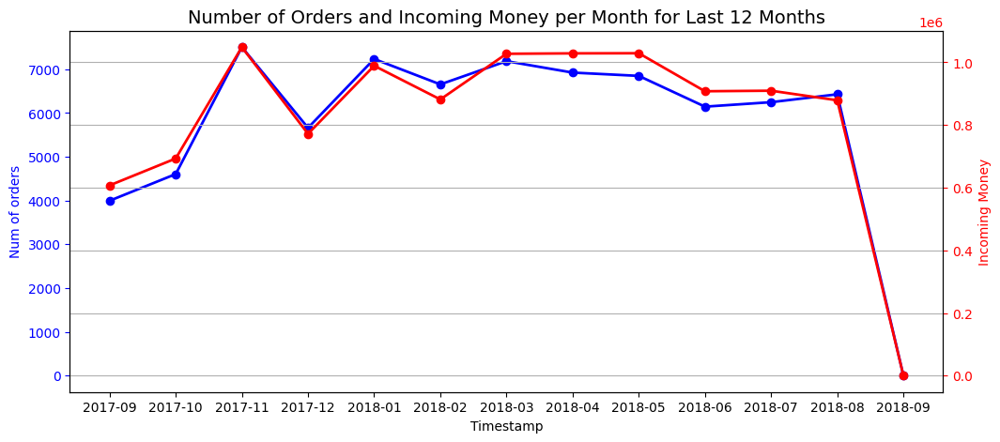

In [96]:
# Create the first plot
fig, ax1 = plt.subplots(figsize=(12, 5))

# Plot the first dataset on the first y-axis
ax1.plot(monthly_orders_df["order_purchase_timestamp"], monthly_orders_df["num_of_order"], marker='o', linewidth=2, color='b', label='Num of orders')
ax1.set_xlabel('Timestamp')
ax1.set_ylabel('Num of orders', color='b')
ax1.tick_params('y', colors='b')

# Create a second y-axis
ax2 = ax1.twinx()

# Plot the second dataset on the second y-axis
ax2.plot(monthly_orders_df["order_purchase_timestamp"], monthly_orders_df["revenue"], marker='o', linewidth=2, color='r', label='Incoming Money')
ax2.set_ylabel('Incoming Money', color='r')
ax2.tick_params('y', colors='r')

plt.title("Number of Orders and Incoming Money per Month for Last 12 Months", loc="center", fontsize=14) 
plt.grid()
plt.xticks(fontsize=10) 
plt.yticks(fontsize=10) 
plt.show()

### Q2: Which state has spent the most money?

#### Map Preparation

In [97]:
df_all = df_all.dropna(subset=['geolocation_lat_x', 'geolocation_lng_x'])

In [98]:
df_all['customer_zip_code_prefix'] = df_all['customer_zip_code_prefix'].astype(str)

In [99]:
with urlopen('https://raw.githubusercontent.com/codeforamerica/click_that_hood/master/public/data/brazil-states.geojson') as response:
    Brazil = json.load(response)

state_id_map = {}
for feature in Brazil ['features']:
    feature['id'] = feature['properties']['name']
    state_id_map[feature['properties']['sigla']] = feature['id']

In [100]:
state_codes = ['SP', 'BA', 'GO', 'RN', 'PR', 'RS', 'RJ', 'MG', 'SC', 'RR', 'PE',
               'TO', 'CE', 'DF', 'SE', 'MT', 'PB', 'PA', 'RO', 'ES', 'AP', 'MS',
               'MA', 'PI', 'AL', 'AC', 'AM']

state_names = ['São Paulo', 'Bahia', 'Goiás', 'Rio Grande do Norte', 'Paraná', 'Rio Grande do Sul',
               'Rio de Janeiro', 'Minas Gerais', 'Santa Catarina', 'Roraima', 'Pernambuco',
               'Tocantins', 'Ceará', 'Distrito Federal', 'Sergipe', 'Mato Grosso', 'Paraíba',
               'Pará', 'Rondônia', 'Espírito Santo', 'Amapá', 'Mato Grosso do Sul',
               'Maranhão', 'Piauí', 'Alagoas', 'Acre', 'Amazonas']

# Create a dictionary mapping state codes to state names
state_dict = dict(zip(state_codes, state_names))

# Map the state codes to their corresponding full names
mapped_state_names = [state_dict[code] for code in state_codes]

state_dict = dict(zip(state_codes, state_names))

df_all['customer_state_name'] = df_all['customer_state'].map(state_dict)
df_all['seller_state_name'] = df_all['seller_state'].map(state_dict)

#### Plotting

In [101]:
state_price_cust_means = df_all.groupby(by='customer_state_name')['price'].mean().reset_index()
range_cust_min = state_price_cust_means["price"].min()
range_cust_max = state_price_cust_means["price"].max()

fig = px.choropleth(state_price_cust_means, 
                   geojson=Brazil, 
                   locations='customer_state_name', 
                   color='price',
                   color_continuous_scale="Viridis",
                   range_color=(range_cust_min, range_cust_max),
                   scope="south america",
                   labels={'price':'price'}
                  )
fig.update_layout(margin={"r":0, "t":0, "l":0, "b":0})
fig.show()

### Q3: What is the demographic breakdown of customer payment types?"

In [102]:
unique_payment_types = df_all["payment_type"].unique()

payment_type_mapping = {payment_type: index + 1 for index, payment_type in enumerate(unique_payment_types)}

# Map the payment types to numerical values
df_all["payment_type_numeric"] = df_all["payment_type"].map(payment_type_mapping)

payment_type_mapping

{'credit_card': 1, 'voucher': 2, 'boleto': 3, 'debit_card': 4}

In [103]:
# Create dataframe which calculate number of orders for each state
num_of_orders = df_all.groupby(by=['customer_state_name'])['order_id'].nunique().reset_index()

In [104]:
num_of_orders

,customer_state_name,order_id
0,Acre,81
1,Alagoas,411
2,Amapá,68
3,Amazonas,148
4,Bahia,3355
5,Ceará,1324
6,Distrito Federal,1963
7,Espírito Santo,2018
8,Goiás,1998
9,Maranhão,738


In [105]:
# Find most used payment method across states
payment_method = df_all.groupby(by=['customer_state_name', 'payment_type'])['order_id'].nunique().reset_index()

payment_method_max = payment_method.loc[payment_method.groupby('customer_state_name')['order_id'].idxmax()]
payment_method_max

,customer_state_name,payment_type,order_id
1,Acre,credit_card,61
5,Alagoas,credit_card,336
9,Amapá,credit_card,47
12,Amazonas,credit_card,124
16,Bahia,credit_card,2623
20,Ceará,credit_card,1078
24,Distrito Federal,credit_card,1560
28,Espírito Santo,credit_card,1554
32,Goiás,credit_card,1500
36,Maranhão,credit_card,529


In [106]:
# Join table num_of_orders and payment_method to get percentage of credit card usage overall all payment methods

df_payment_percentage = pd.merge(
    left=payment_method_max,
    right=num_of_orders,
    how="left",
    left_on="customer_state_name",
    right_on="customer_state_name"
)

# Calculate percentage value
df_payment_percentage["credit_card_percentage"] = df_payment_percentage["order_id_x"]*100/df_payment_percentage["order_id_y"]

In [107]:
# Create map based on percentage value of credit card usage

range_pp_min = df_payment_percentage["credit_card_percentage"].min()
range_pp_max = df_payment_percentage["credit_card_percentage"].max()

fig = px.choropleth(df_payment_percentage, 
                   geojson=Brazil, 
                   locations='customer_state_name', 
                   color='credit_card_percentage',
                   color_continuous_scale="Viridis",
                   range_color=(range_pp_min, range_pp_max),
                   scope="south america",
                   labels={'credit_card_percentage':'credit_card_percentage'}
                  )
fig.update_layout(margin={"r":0, "t":0, "l":0, "b":0})
fig.show()

### Q4: Which sellers generate the highest revenue, have the highest review ratings, and the fastest approval times?

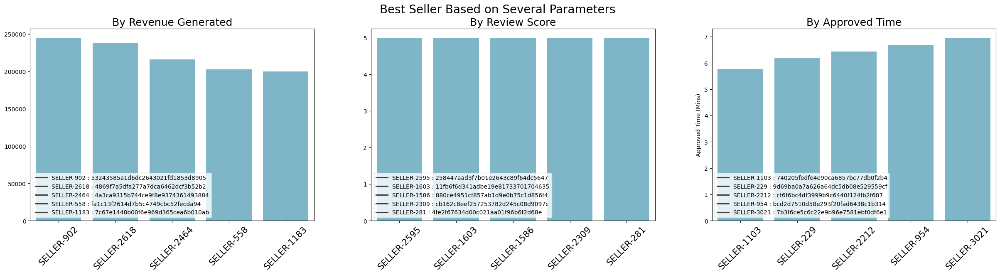

In [108]:
# Prepare dataframe
df_by_price = df_seller_performance.sort_values(by="price", ascending=False).head(5).reset_index()
df_by_review = df_seller_performance.sort_values(by="review_score", ascending=False).head(5).reset_index()
df_by_approved_time = df_seller_performance.sort_values(by="approved_time_m", ascending=True).head(5).reset_index()

# Create long seller id legend to be print out - by price
seller_by_price_legends = []

for seller in df_by_price['seller_id_short']:
    seller_legend = seller + ' : ' + seller_short_to_long[seller]
    seller_by_price_legends.append(seller_legend)

# Create long seller id legend to be print out - by review
seller_by_review_legends = []

for seller in df_by_review['seller_id_short']:
    seller_legend = seller + ' : ' + seller_short_to_long[seller]
    seller_by_review_legends.append(seller_legend)

# Create long seller id legend to be print out - by approved time
seller_by_app_legends = []

for seller in df_by_approved_time['seller_id_short']:
    seller_legend = seller + ' : ' + seller_short_to_long[seller]
    seller_by_app_legends.append(seller_legend)

fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(30, 6))
 
colors = ["#72BCD4", "#72BCD4", "#72BCD4", "#72BCD4", "#72BCD4"]
 
sns.barplot(y="price", x="seller_id_short", data=df_by_price, hue="seller_id_short", palette=colors, ax=ax[0])
ax[0].set_ylabel(None)
ax[0].set_xlabel(None)
ax[0].set_title("By Revenue Generated", loc="center", fontsize=18)
ax[0].tick_params(axis ='x', labelsize=15)
ax[0].legend(seller_by_price_legends, loc='lower left')

sns.barplot(y="review_score", x="seller_id_short", data=df_by_review,hue="seller_id_short", palette=colors, ax=ax[1])
ax[1].set_ylabel(None)
ax[1].set_xlabel(None)
ax[1].set_title("By Review Score", loc="center", fontsize=18)
ax[1].tick_params(axis='x', labelsize=15)
ax[1].legend(seller_by_review_legends, loc='lower left')
 
sns.barplot(y="approved_time_m", x="seller_id_short", data=df_by_approved_time, hue="seller_id_short", palette=colors, ax=ax[2])
ax[2].set_ylabel("Approved Time (Mins)")
ax[2].set_xlabel(None)
ax[2].set_title("By Approved Time", loc="center", fontsize=18)
ax[2].tick_params(axis='x', labelsize=15)
ax[2].legend(seller_by_app_legends, loc='lower left')

for ax_ in ax:
    ax_.tick_params(axis='x', labelrotation=45)
    
plt.suptitle("Best Seller Based on Several Parameters", fontsize=20)
plt.show()

### Q5: Which product categories are the best-sellers, and what is the distribution of their shipping distances?

In [109]:
# Create dataframe group by product category and distance group
distance_group_product_category = df_all.groupby(by=["product_category_name_english","distance_group"]).agg({
    "price": "sum",
    "order_id":"nunique"}).sort_values(by="order_id", ascending=False).reset_index()

# Create dataframe group only by product category
product_category_group = df_all.groupby(by="product_category_name_english").agg({
    "price": "sum",
    "order_id":"nunique"}).sort_values(by="order_id", ascending=False).reset_index()

# Merge both grouped category to sort based on top sold products
proportion_distance_group = pd.merge(
    left=distance_group_product_category,
    right=product_category_group,
    how="left",
    left_on="product_category_name_english",
    right_on="product_category_name_english"
)

# Dive in deeper to the most 10 sold product category, assuming each product_catgory have 3 distance group, so it will be filtered on top 30 rows
proportion_distance_group_10 =  proportion_distance_group.nlargest(30, 'order_id_y')

In [110]:
proportion_distance_group.shape

(204, 6)

In [111]:
# Pivot the DataFrame and sort based on number of solds 
pivot_num_orders = proportion_distance_group_10.pivot_table(index='product_category_name_english', columns='distance_group', values='order_id_x', aggfunc='sum', fill_value=0).reset_index()
pivot_num_orders["Sum"] = pivot_num_orders["Long"] + pivot_num_orders["Medium"] + pivot_num_orders["Short"]
pivot_num_orders = pivot_num_orders.sort_values(by="Sum", ascending=False)
category_sequence = pivot_num_orders['product_category_name_english'] # Take the sequence order in purpose to sorting index on next graph
pivot_num_orders.drop(columns="Sum", inplace=True)

# Creating dataframe consisting revenue generated each product category and filtered to have same categories as pivot_num_orders dataframe
df_revenue_category = df_all.groupby(by='product_category_name_english')['price'].sum().reset_index()
df_revenue_cat_filtered = df_revenue_category[df_revenue_category.product_category_name_english.isin(pivot_num_orders.product_category_name_english)]

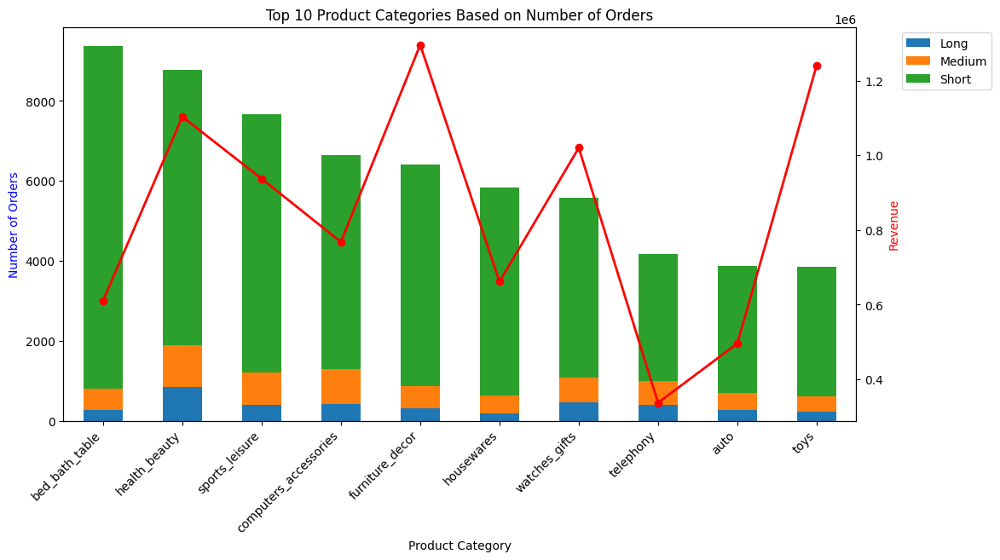

In [112]:
# Create a figure and axis
fig, ax1 = plt.subplots(figsize=(12, 6))

# Plot the first bar chart using Pandas DataFrame plot function on the first y-axis
pivot_num_orders.plot(x="product_category_name_english", kind='bar', stacked=True, ax=ax1)
ax1.set_xlabel('Product Category')
ax1.set_ylabel('Number of Orders', color='b')
ax1.set_xticklabels(pivot_num_orders["product_category_name_english"], rotation=45, ha='right')
ax1.legend(loc='upper left', bbox_to_anchor=(1.05, 1))

# Create second y-axis
ax2 = ax1.twinx()

ax2.plot(df_revenue_cat_filtered["product_category_name_english"], df_revenue_cat_filtered["price"], marker='o', linewidth=2, color='r', label='Revenue')
ax2.set_ylabel('Revenue', color='r')

# Show the plot
plt.title('Top 10 Product Categories Based on Number of Orders')
plt.show()


In [113]:
# Filter the DataFrame based on the "distance_group" column
distance_short_product_category = proportion_distance_group[proportion_distance_group["distance_group"] == "Short"].head(5)
distance_medium_product_category = proportion_distance_group[proportion_distance_group["distance_group"] == "Medium"].head(5)
distance_long_product_category = proportion_distance_group[proportion_distance_group["distance_group"] == "Long"].head(5)

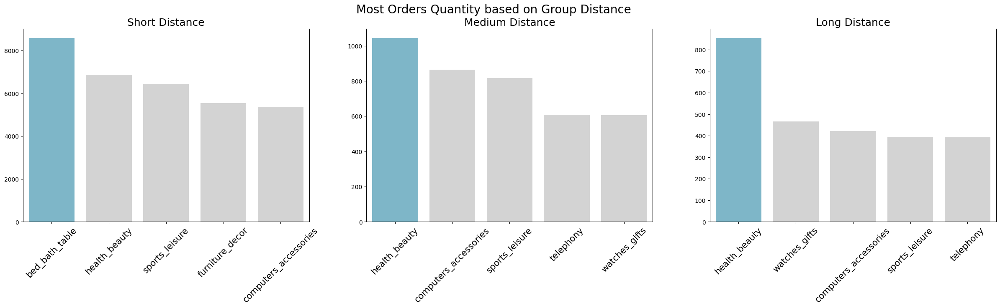

In [114]:
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(30, 6))
 
colors = ["#72BCD4", "#D3D3D3", "#D3D3D3", "#D3D3D3", "#D3D3D3"]
 
sns.barplot(y="order_id_x", x="product_category_name_english", data=distance_short_product_category, hue="product_category_name_english", palette=colors, ax=ax[0])
ax[0].set_ylabel(None)
ax[0].set_xlabel(None)
ax[0].set_title("Short Distance", loc="center", fontsize=18)
ax[0].tick_params(axis ='x', labelsize=15)

sns.barplot(y="order_id_x", x="product_category_name_english", data=distance_medium_product_category,hue="product_category_name_english", palette=colors, ax=ax[1])
ax[1].set_ylabel(None)
ax[1].set_xlabel(None)
ax[1].set_title("Medium Distance", loc="center", fontsize=18)
ax[1].tick_params(axis='x', labelsize=15)
 
sns.barplot(y="order_id_x", x="product_category_name_english", data=distance_long_product_category, hue="product_category_name_english", palette=colors, ax=ax[2])
ax[2].set_ylabel(None)
ax[2].set_xlabel(None)
ax[2].set_title("Long Distance", loc="center", fontsize=18)
ax[2].tick_params(axis='x', labelsize=15)

for ax_ in ax:
    ax_.tick_params(axis='x', labelrotation=45)
    
plt.suptitle("Most Orders Quantity based on Group Distance", fontsize=20)
plt.show()

### Q6: How does the relationship between product volume, product weight, seller-customer distance relate to item price, freight value, and delivery duration?

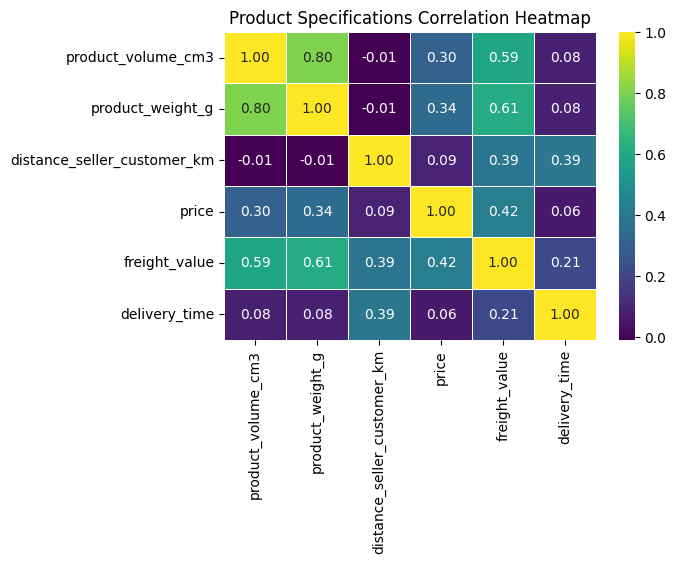

In [115]:
plt.figure(figsize=(6, 4))
sns.heatmap(freight_value_corr, cmap='viridis', annot=True, fmt='.2f', linewidths=.5)

# Customize the plot
plt.title('Product Specifications Correlation Heatmap')
plt.show()

### Q7: What is the relationship between the number of photos, description length, delivery time, review score, and response time to reviews?

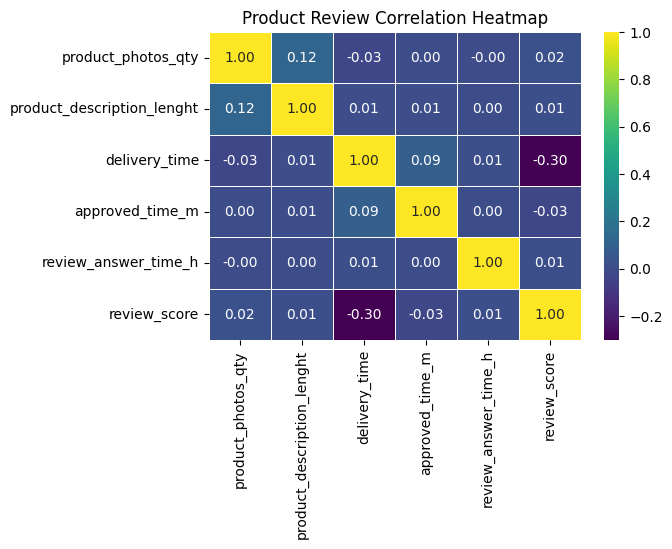

In [116]:
plt.figure(figsize=(6, 4))
sns.heatmap(review_corr, cmap='viridis', annot=True, fmt='.2f', linewidths=.5)

# Customize the plot
plt.title('Product Review Correlation Heatmap')
plt.show()

### Q8: Who are the top customers based on RFM parameters?

In [117]:
df_rfm = df_all.groupby(by="customer_unique_id_short", as_index=False).agg({
    "order_purchase_timestamp": "max", # mengambil tanggal order terakhir
    "order_id": "nunique", # menghitung jumlah order
    "price": "sum" # menghitung jumlah revenue yang dihasilkan
})
df_rfm.columns = ["customer_id", "max_order_timestamp", "frequency", "monetary"]
 
# menghitung kapan terakhir pelanggan melakukan transaksi (hari)
df_rfm["max_order_timestamp"] = df_rfm["max_order_timestamp"].dt.date
recent_date = df_all["order_purchase_timestamp"].dt.date.max()
df_rfm["recency"] = df_rfm["max_order_timestamp"].apply(lambda x: (recent_date - x).days)
 
df_rfm.drop("max_order_timestamp", axis=1, inplace=True)
df_rfm.head()

,customer_id,frequency,monetary,recency
0,000075e5,1,49.90,240
1,0002336f,1,73.76,312
2,00058649,1,65.44,531
3,0007d074,2,221.99,344
4,00081da6,1,99.00,291


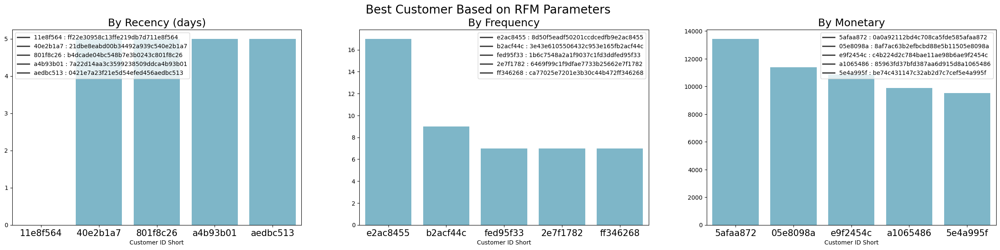

In [118]:
df_top_recency = df_rfm.sort_values(by="recency", ascending=True).head(5)
df_top_frequency = df_rfm.sort_values(by="frequency", ascending=False).head(5)
df_top_monetary = df_rfm.sort_values(by="monetary", ascending=False).head(5)

# Create long seller id legend to be print out - by recency
by_recency_legends = []
for cust in df_top_recency['customer_id']:
    by_recency_legend = cust + ' : ' + cust_short_to_long[cust]
    by_recency_legends.append(by_recency_legend)

by_frequency_legends = []
for cust in df_top_frequency['customer_id']:
    by_frequency_legend = cust + ' : ' + cust_short_to_long[cust]
    by_frequency_legends.append(by_frequency_legend)

by_monetary_legends = []
for cust in df_top_monetary['customer_id']:
    by_monetary_legend = cust + ' : ' + cust_short_to_long[cust]
    by_monetary_legends.append(by_monetary_legend)

fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(30, 6))

colors = ["#72BCD4", "#72BCD4", "#72BCD4", "#72BCD4", "#72BCD4"]

sns.barplot(y="recency", x="customer_id", data=df_top_recency,hue="customer_id", palette=colors, ax=ax[0])
ax[0].set_ylabel(None)
ax[0].set_xlabel('Customer ID Short')
ax[0].set_title("By Recency (days)", loc="center", fontsize=18)
ax[0].tick_params(axis ='x', labelsize=15)
ax[0].legend(by_recency_legends)

sns.barplot(y="frequency", x="customer_id", data=df_top_frequency,hue="customer_id", palette=colors, ax=ax[1])
ax[1].set_ylabel(None)
ax[1].set_xlabel('Customer ID Short')
ax[1].set_title("By Frequency", loc="center", fontsize=18)
ax[1].tick_params(axis='x', labelsize=15)
ax[1].legend(by_frequency_legends)

sns.barplot(y="monetary", x="customer_id", data=df_top_monetary,hue="customer_id", palette=colors, ax=ax[2])
ax[2].set_ylabel(None)
ax[2].set_xlabel('Customer ID Short')
ax[2].set_title("By Monetary", loc="center", fontsize=18)
ax[2].tick_params(axis='x', labelsize=15)
ax[2].legend(by_monetary_legends)
 
plt.suptitle("Best Customer Based on RFM Parameters", fontsize=20)
plt.show()

## Conclusion - Whole Dataset Time Frame

- **Conclusion Q1**:
  - The number of orders in the last 12 months has been fluctuating. The highest number of orders was in November 2017, while the lowest was in September 2018, approaching zero because the latest available data in the database is dated November 3, 2018, with only one transaction recorded for that month.
  - The revenue shows a positive correlation with the number of orders. However, from March 2018 to May 2018, when the number of orders decreased, the revenue did not decrease.

- **Conclusion Q2**: The state of Praiba has the highest expenditure, averaging 191.99, while the lowest expenditure is in the state of Sao Paulo, averaging 109.70.

- **Conclusion Q3**: The majority of buyers throughout Brazil use credit cards for payment. The state of Amazonas has 83.78% of transactions made using credit cards. The state with the lowest credit card usage is Amapa, with a percentage of 69.12%, which still remains above 50%.

- **Conclusion Q4**: The seller with the short ID SELLER-2618 generates the highest revenue. Regarding review scores, the top 5 sellers have a score of 5 (without considering the quantity of items sold). The fastest approved time is held by SELLER-1103 with an average of just under 6 minutes.

- **Conclusion Q5**: The product category 'bed_bath_table' has the highest number of purchases. Among the top 10 products sold, the dominant shipping distance category is short-distance, defined as <= 1000km. However, in terms of revenue generated, among the top 10 best-selling products, 'furniture_decor' generates the highest revenue.

- **Conclusion Q6**:
  - The factor most positively correlated with freight value is the weight of the item, followed by the item's volume, then the item's price, and finally, the shipping distance.
  - On the other hand, the factor most positively correlated with delivery duration is the shipping distance, followed by the freight value.

- **Conclusion 7**:
  - Low review scores are highly influenced by high delivery times, with a correlation value of -0.3. The number of photos and description length barely affects the review score.
  - Review response time does not correlate with any of the determined parameters.

- **Conclusion 8**:
  - The customer who made the most recent purchase, 0 days before the latest dataset, has the short ID 11e8f564.
  - The customer with the highest purchase frequency, 17 times, has the short ID e2ac8455.
  - The customer with the highest expenditure, R$13440, has the short ID 5afaa872.

In [119]:
# Converts compiled dataset to CSV files for Streamlit dashboard development
# df_all.to_csv('all_data_e_commerce.csv')